<a href="https://colab.research.google.com/github/UpendraVishwanathYS/IISc_Deep_Learning_Course_Assignment/blob/main/M1_AST_05_Data_Visualization_A.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Advanced Programme in Deep Learning (Foundations and Applications)
## A Program by IISc and TalentSprint
### Assignment 05: Data Visualization

## Learning Objectives

 At the end of the experiment, you will be able to:

* understand the importance of data visualization
* implement data visualization using different ways
* visualize the outliers in a dataset
* implement the different types of graphs and charts

### Setup Steps:

In [ ]:
#@title Please enter your registration id to start: { run: "auto", display-mode: "form" }
Id = "" #@param {type:"string"}

In [ ]:
#@title Please enter your password (normally your phone number) to continue: { run: "auto", display-mode: "form" }
password = "" #@param {type:"string"}

In [2]:
from IPython import get_ipython
import warnings
warnings.filterwarnings("ignore")

ipython = get_ipython()
ipython.magic("sx wget -q https://cdn.iisc.talentsprint.com/DLFA/Experiment_related_data/breast_cancer.csv")
ipython.magic("sx wget -q https://cdn.iisc.talentsprint.com/DLFA/Experiment_related_data/iris.csv")
ipython.magic("sx wget -q https://cdn.iisc.talentsprint.com/DLFA/Experiment_related_data/Hitters.csv")

[]

In [ ]:
#@title Run this cell to complete the setup for this Notebook
from IPython import get_ipython
import warnings
warnings.filterwarnings("ignore")

ipython = get_ipython()

notebook= "M1_AST_05_Data_Visualization_A" #name of the notebook

def setup():
    ipython.magic("sx wget -q https://cdn.iisc.talentsprint.com/DLFA/Experiment_related_data/breast_cancer.csv")
    ipython.magic("sx wget -q https://cdn.iisc.talentsprint.com/DLFA/Experiment_related_data/iris.csv")
    ipython.magic("sx wget -q https://cdn.iisc.talentsprint.com/DLFA/Experiment_related_data/Hitters.csv")
    from IPython.display import HTML, display
    display(HTML('<script src="https://dashboard.talentsprint.com/aiml/record_ip.html?traineeId={0}&recordId={1}"></script>'.format(getId(),submission_id)))
    print("Setup completed successfully")
    return

def submit_notebook():
    ipython.magic("notebook -e "+ notebook + ".ipynb")

    import requests, json, base64, datetime

    url = "https://dashboard.talentsprint.com/xp/app/save_notebook_attempts"
    if not submission_id:
      data = {"id" : getId(), "notebook" : notebook, "mobile" : getPassword()}
      r = requests.post(url, data = data)
      r = json.loads(r.text)

      if r["status"] == "Success":
          return r["record_id"]
      elif "err" in r:
        print(r["err"])
        return None
      else:
        print ("Something is wrong, the notebook will not be submitted for grading")
        return None

    elif getAnswer1() and getAnswer2() and getComplexity() and getAdditional() and getConcepts() and getComments() and getMentorSupport():
      f = open(notebook + ".ipynb", "rb")
      file_hash = base64.b64encode(f.read())

      data = {"complexity" : Complexity, "additional" :Additional,
              "concepts" : Concepts, "record_id" : submission_id,
              "answer1" : Answer1, "answer2" : Answer2, "id" : Id, "file_hash" : file_hash,
              "notebook" : notebook,
              "feedback_experiments_input" : Comments,
              "feedback_mentor_support": Mentor_support}
      r = requests.post(url, data = data)
      r = json.loads(r.text)
      if "err" in r:
        print(r["err"])
        return None
      else:
        print("Your submission is successful.")
        print("Ref Id:", submission_id)
        print("Date of submission: ", r["date"])
        print("Time of submission: ", r["time"])
        print("View your submissions: https://learn-iisc.talentsprint.com/notebook_submissions")
        #print("For any queries/discrepancies, please connect with mentors through the chat icon in LMS dashboard.")
        return submission_id
    else: submission_id


def getAdditional():
  try:
    if not Additional:
      raise NameError
    else:
      return Additional
  except NameError:
    print ("Please answer Additional Question")
    return None

def getComplexity():
  try:
    if not Complexity:
      raise NameError
    else:
      return Complexity
  except NameError:
    print ("Please answer Complexity Question")
    return None

def getConcepts():
  try:
    if not Concepts:
      raise NameError
    else:
      return Concepts
  except NameError:
    print ("Please answer Concepts Question")
    return None


# def getWalkthrough():
#   try:
#     if not Walkthrough:
#       raise NameError
#     else:
#       return Walkthrough
#   except NameError:
#     print ("Please answer Walkthrough Question")
#     return None

def getComments():
  try:
    if not Comments:
      raise NameError
    else:
      return Comments
  except NameError:
    print ("Please answer Comments Question")
    return None


def getMentorSupport():
  try:
    if not Mentor_support:
      raise NameError
    else:
      return Mentor_support
  except NameError:
    print ("Please answer Mentor support Question")
    return None

def getAnswer1():
  try:
    if not Answer1:
      raise NameError
    else:
      return Answer1
  except NameError:
    print ("Please answer Question 1")
    return None

def getAnswer2():
  try:
    if not Answer2:
      raise NameError
    else:
      return Answer2
  except NameError:
    print ("Please answer Question 2")
    return None


def getId():
  try:
    return Id if Id else None
  except NameError:
    return None

def getPassword():
  try:
    return password if password else None
  except NameError:
    return None

submission_id = None
### Setup
if getPassword() and getId():
  submission_id = submit_notebook()
  if submission_id:
    setup()
else:
  print ("Please complete Id and Password cells before running setup")



#### Importing required packages

In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

**Importing data as Pandas dataframe**

Seaborn is a data visualization library built on top of matplotlib and closely integrated with pandas data structures in Python.

In this section, we will import a dataset from seaborn.

In [4]:
# Loading data
data = sns.load_dataset('tips')

The "tips" dataset is a built-in dataset in the Seaborn data visualization library. It contains information about tips given to restaurant staff along with some other details. When you load the dataset using the sns.load_dataset('tips') command, you get a DataFrame with the following attributes:

**total_bill:** This attribute represents the total bill (including tip) for a meal, recorded in dollars.

**tip:** The amount of tip given for the meal, recorded in dollars.

**sex:** The gender of the person who paid the bill, recorded as 'Male' or 'Female'.

**smoker:** Indicates whether the party included smokers or non-smokers. It is recorded as 'Yes' or 'No'.

**day:** The day of the week on which the meal was taken, recorded as 'Thur' for Thursday, 'Fri' for Friday, 'Sat' for Saturday, or 'Sun' for Sunday.

**time:** Indicates whether the meal was served during lunch or dinner, recorded as 'Lunch' or 'Dinner'.

**size:** The number of people in the party.

The dataset is often used for exploring relationships between different variables, especially for visualizations and statistical analyses. It provides a simple set of data related to restaurant tipping, making it suitable for various analyses and demonstrations.

 **01.** For the given dataset, perform the following:

1. Display first 5 and last 5 entries from the dataset
2. Plot a Univariate Distribution for `'total_bill'` from dataframe using distplot()

**Hint:** The **`distplot()`** function provides a quick look at univariate distribution. This function will plot a histogram that fits the kernel density estimate of the data

<Axes: xlabel='total_bill', ylabel='Density'>

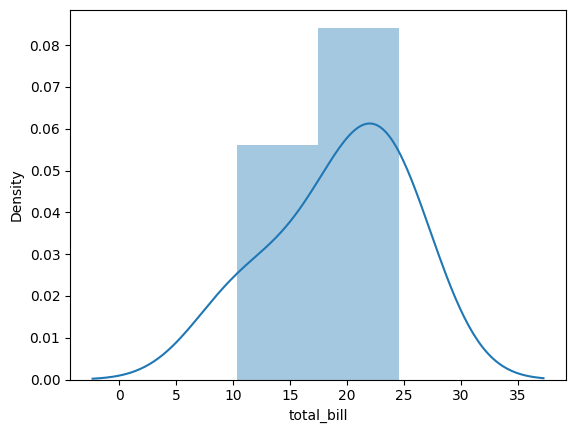

In [8]:
# YOUR CODE HERE
sns.distplot(data['total_bill'].head(5))

**02.** Plot a FacetGrid for both male and female records with `"total_bill"` and `"tip"` in X and Y axis respectively

**FacetGrid()** class helps in visualizing distribution of one variable as well as the relationship between multiple variables separately within subsets of your dataset using multiple panels

**Hint:** Take hue as `"smoker"`

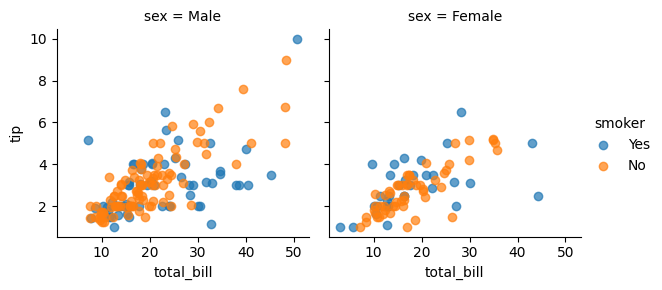

In [9]:
# YOUR CODE HERE
g = sns.FacetGrid(data, col="sex", hue="smoker")
g.map(plt.scatter, "total_bill", "tip", alpha=.7)
g.add_legend();

**03.** Plot a Histogram for the columns `"total_bill", "size", "tip"`


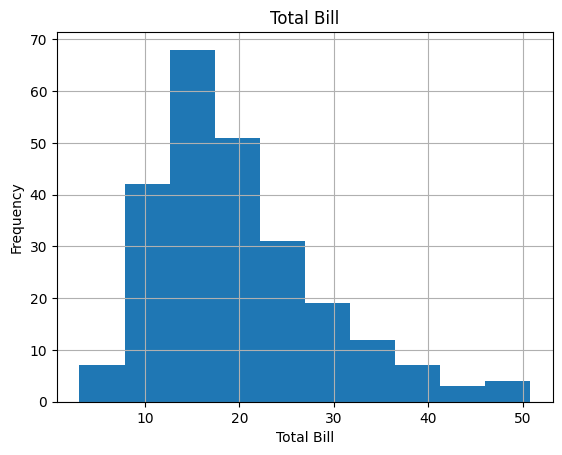

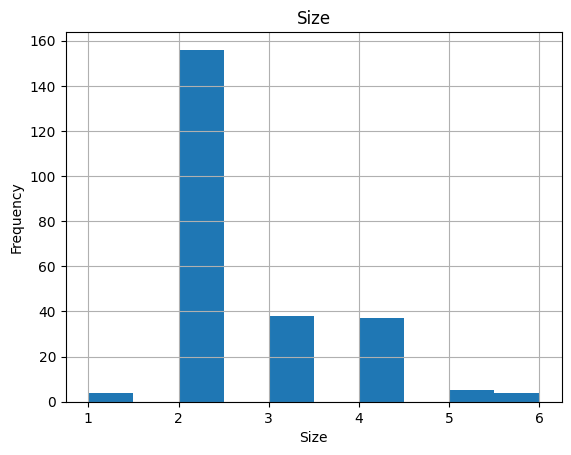

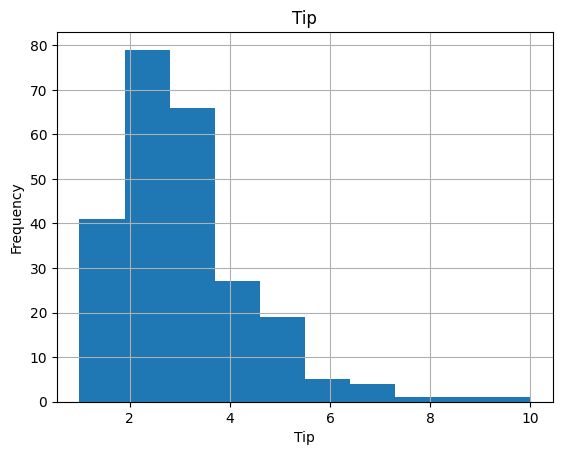

In [13]:
# YOUR CODE HERE
data['total_bill'].hist()
plt.title('Total Bill')
plt.xlabel('Total Bill')
plt.ylabel('Frequency')
plt.show()
data['size'].hist()
plt.title('Size')
plt.xlabel('Size')
plt.ylabel('Frequency')
plt.show()
data['tip'].hist()
plt.title('Tip')
plt.xlabel('Tip')
plt.ylabel('Frequency')
plt.show()

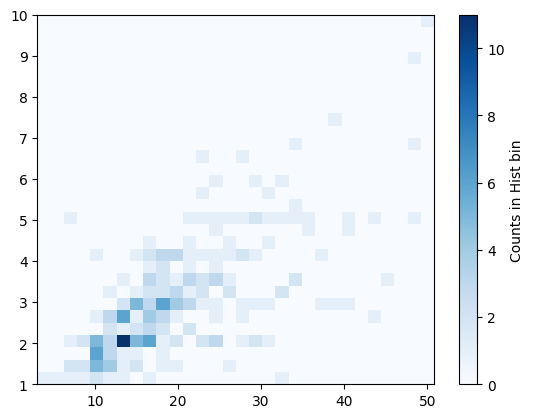

In [14]:
x = data['total_bill']
y = data['tip']
plt.hist2d(x, y, bins=30, cmap='Blues')
cb = plt.colorbar()
cb.set_label('Counts in Hist bin')

 **04.** Perform scatter plot with

  * X-label = `'total_bill'`
  * Y-label = `'tip'`
  * Title = "Scatter Plot"

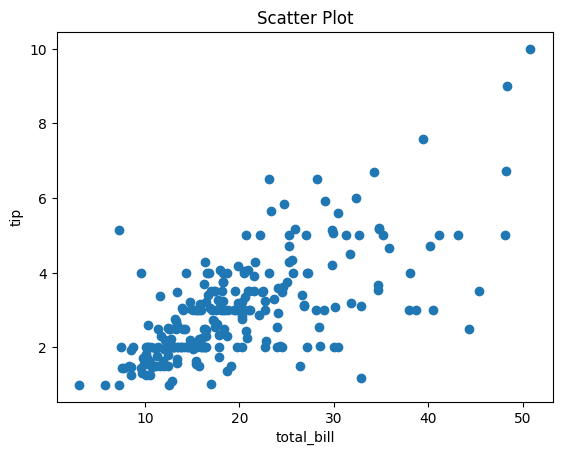

In [15]:
# YOUR CODE HERE
plt.scatter(data['total_bill'], data['tip'])
plt.xlabel('total_bill')
plt.ylabel('tip')
plt.title('Scatter Plot')
plt.show()

**05.** Visualize pairwise relationship with a **pairplot()**

**Hint:** Take hue as `"smoker"`

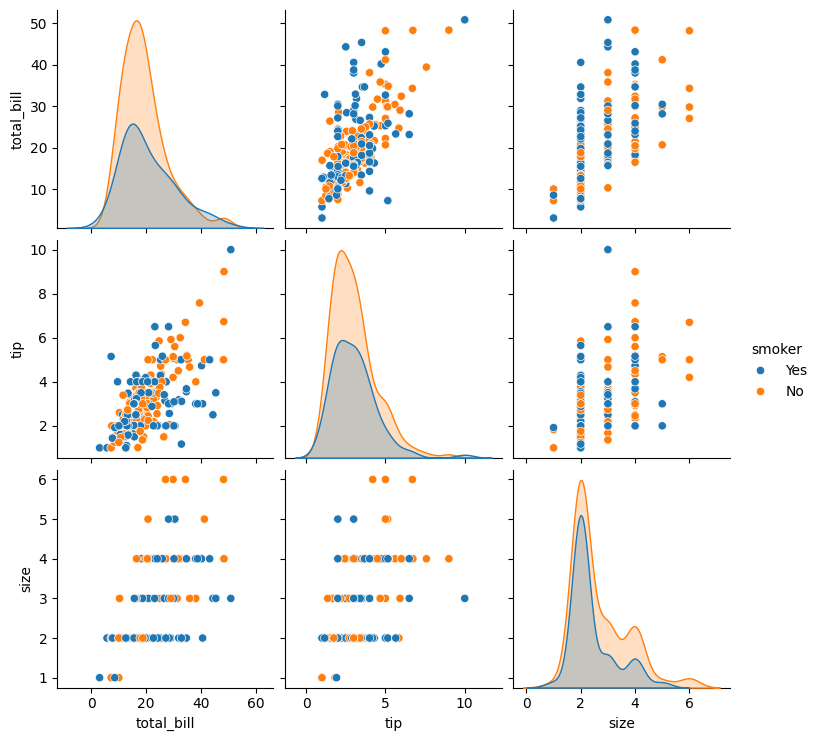

In [16]:
# YOUR CODE HERE
sns.pairplot(data, hue='smoker')

**06.** Visualize a **Strip Plot** with

  * X-label = `'day'`
  * Y-label = `'total_bill'`
  * Title = "Strip Plot"

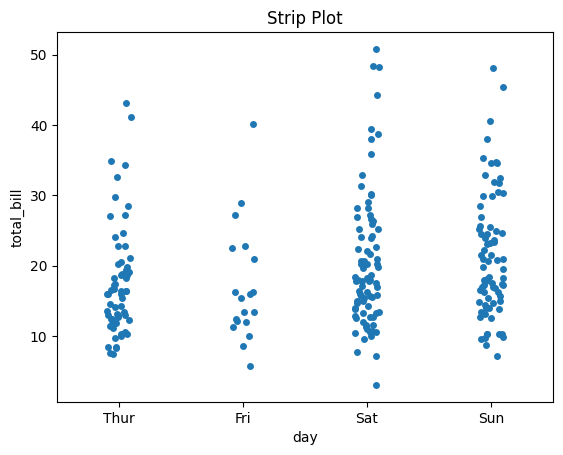

In [17]:
# YOUR CODE HERE
sns.stripplot(x='day', y='total_bill', data=data)
plt.xlabel('day')
plt.ylabel('total_bill')
plt.title('Strip Plot')
plt.show()

**07.** From the given dataset, visualize a combined plot of both **stripplot and the boxplot** to view the outliers with

 * X-label = `'day'`
 * Y-label = `'total_bill'`
 * Title = "Strip and Box Plot"

<Axes: xlabel='day', ylabel='total_bill'>

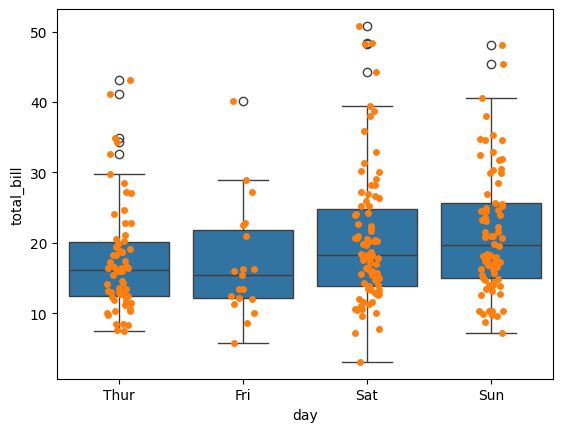

In [18]:
# YOUR CODE HERE
sns.boxplot(x='day', y='total_bill', data=data)
sns.stripplot(x='day', y='total_bill', data=data, jitter=True, edgecolor="gray")

**08.** Display violinplot with
* X-label =`'day'`
* Y-label=`'total_bill'`

<Axes: xlabel='day', ylabel='total_bill'>

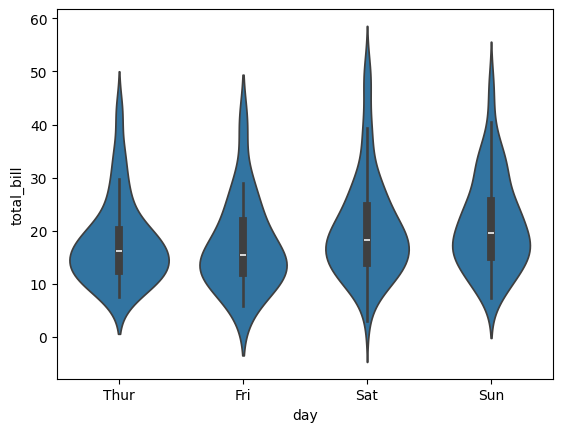

In [19]:
# YOUR CODE HERE
sns.violinplot(x='day', y='total_bill', data=data)

**09.** Draw a barplot with
* X-label =`'day'`
* Y-label=`'total_bill'`

<Axes: xlabel='day', ylabel='total_bill'>

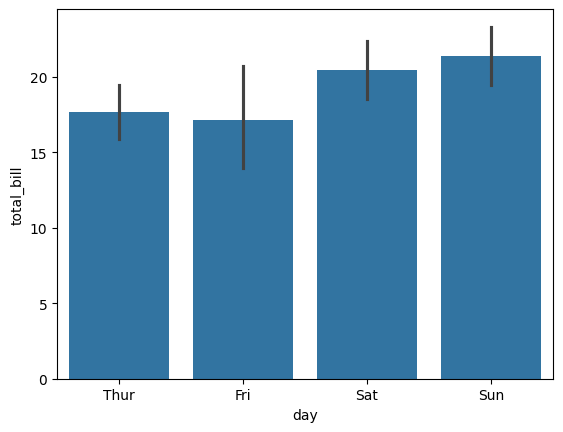

In [20]:
# YOUR CODE HERE
sns.barplot(x='day', y='total_bill', data=data)

Draw the bar plot with smoker value counts from the tips data

In [21]:
# Checking for the unique smoker values
# YOUR CODE HERE
data['smoker'].unique()

['No', 'Yes']
Categories (2, object): ['Yes', 'No']

<Axes: xlabel='smoker', ylabel='count'>

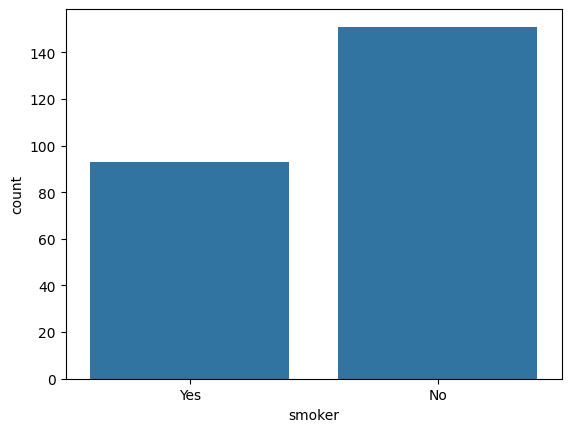

In [22]:
# YOUR CODE HERE
sns.countplot(x='smoker', data=data)

**10.** Plot **`lmplot()`** with

* X-label = `'tip'`
* Y-label = `'total_bill'`

The **lineplot (lmplot)** is one of the most basic plots. It shows a line on a 2 dimensional plane. **lmplot()** method is used to draw a scatter plot onto a FacetGrid

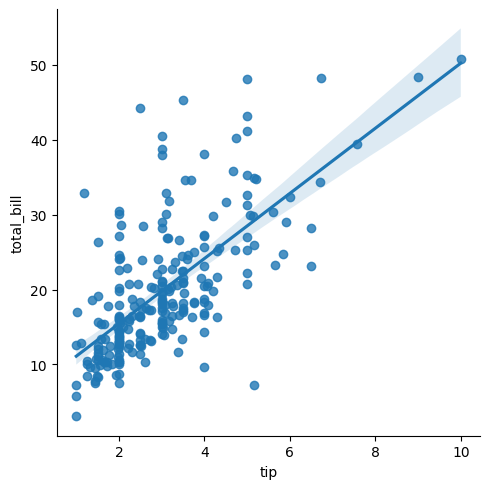

In [23]:
# YOUR CODE HERE
sns.lmplot(x='tip', y='total_bill', data=data)

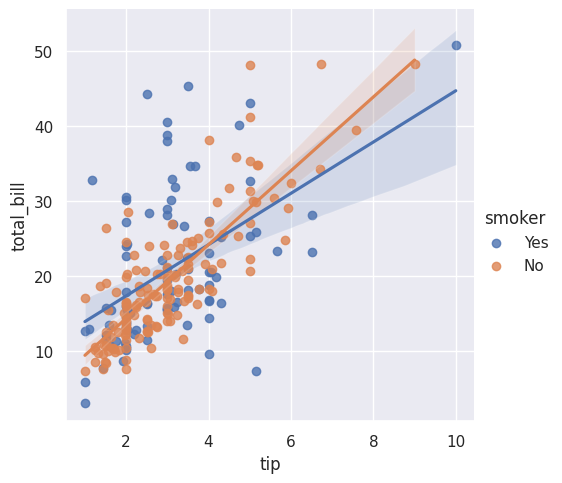

In [24]:
sns.set(style='darkgrid')
# YOUR CODE HERE
sns.lmplot(x='tip', y='total_bill', data=data, hue='smoker')

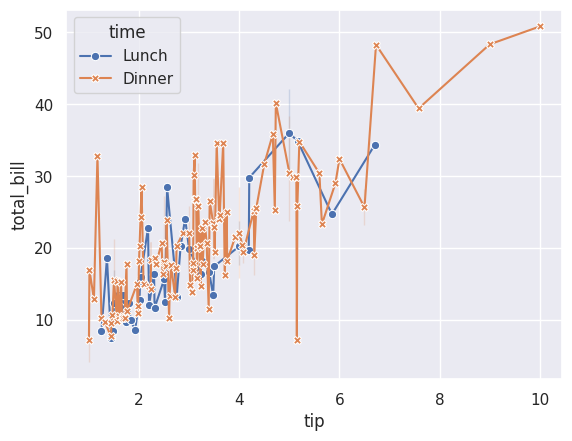

In [25]:
sns.lineplot(x='tip', y='total_bill',
            hue='time', style='time',
            markers=True, dashes=False, data=data);

**11.** Display a Bivariate Distribution using a **`jointplot()`** with

* X-label = `'tip'`
* Y-label = `'total_bill'`

Seaborn's **jointplot** displays a relationship between 2 variables (bivariate) as well as 1D profiles (univariate) in the margins. This plot is a convenience class that wraps JointGrid.

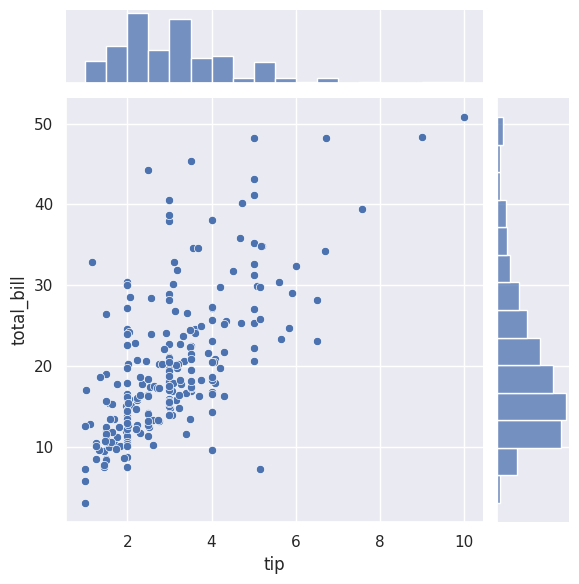

In [26]:
# YOUR CODE HERE
sns.jointplot(x='tip', y='total_bill', data=data)

**12.** For the below-given **`uniform_data`**, plot a **HeatMap**

uniform_data = np.random.rand(10, 12)

<Axes: >

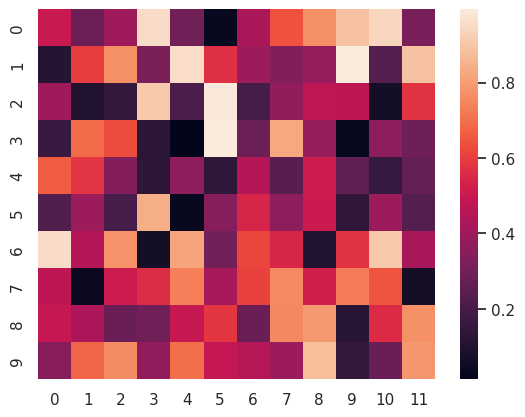

In [28]:
# YOUR CODE HERE
uniform_data = np.random.rand(10, 12)
sns.heatmap(uniform_data)

## Breast Cancer Visualization

Here we use various visualization tools such as scatter plot, heatmap to get a better understanding of visualization by using a Breast Cancer dataset. This dataset has 569 records and we supposed view those records with Benign tumors and those with Malignant tomors.

## Dataset

### History

Breast cancer (BC) is one of the most common cancers among women in the world today. Currently, the average risk of a woman in the United States developing breast cancer sometime in her life is about 13%, which means there is a 1 in 8 chance she will develop breast cancer!. An early diagnosis of BC can greatly improve the prognosis and chance of survival for patients. Thus an accurate identification of malignant tumors is of paramount importance.

### Description

The Breast cancer Data Set consists of 569 data instances. This is a binary classification problem which consists of 2 types of cancer classes. The tumor is classified as **benign (1)** or **malignant (0)** based on its geometry and shape.

The features of the dataset include:

* ID number
* Diagnosis (M = malignant, B = benign)

Ten real-valued features are computed for each cell nucleus:

* radius (mean of distances from center to points on the perimeter)
* texture (standard deviation of gray-scale values)
* perimeter
* area
* smoothness (local variation in radius lengths)
* compactness (perimeter^2 / area - 1.0)
* concavity (severity of concave portions of the contour)
* concave points (number of concave portions of the contour)
* symmetry
* fractal dimension ("coastline approximation" - 1)


The mean, standard error and “worst” or largest (mean of the three largest values) of these features were computed for each image, resulting in 32 features. For instance, field 3 is Mean Radius, field 13 is Radius SE, field 23 is Worst Radius.

Class distribution: 357 benign, 212 malignant

Data source to this experiment : https://archive.ics.uci.edu/ml/datasets/breast+cancer+wisconsin+(diagnostic)



Read the Breast Cancer dataset and see if there are any empty (NaN, NAN, na) or missing values in every column or attribute in the dataset.

In [29]:
breast_cancer = pd.read_csv('breast_cancer.csv')

In [30]:
# First 5 entries of the data
breast_cancer.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [32]:
# YOUR CODE HERE
breast_cancer.isna().sum()

,0
id,0
diagnosis,0
radius_mean,0
texture_mean,0
perimeter_mean,0
area_mean,0
smoothness_mean,0
compactness_mean,0
concavity_mean,0
concave points_mean,0


Count the number of rows and columns (attributes) in the dataset.

In [36]:
# YOUR CODE HERE
breast_cancer.shape

(569, 32)

Get a count of the number of the number of Malignant (M) or Benign (B) cells and visualize the count.

<Axes: xlabel='count', ylabel='diagnosis'>

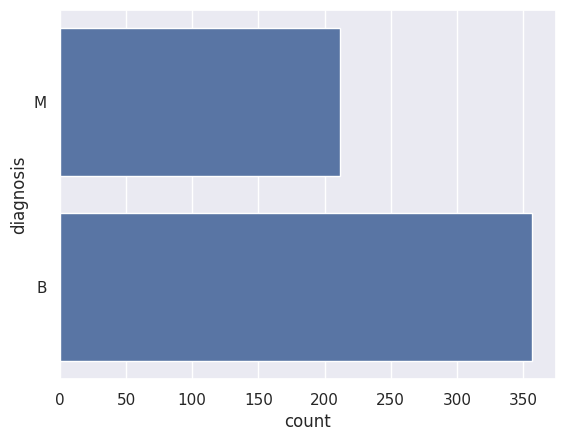

In [38]:
# YOUR CODE HERE
breast_cancer['diagnosis'].value_counts()
#visualize counts:
sns.countplot(breast_cancer['diagnosis'])

Look at the data types to see which columns need to be encoded.

In [39]:
# YOUR CODE HERE
breast_cancer.dtypes

,0
id,int64
diagnosis,object
radius_mean,float64
texture_mean,float64
perimeter_mean,float64
area_mean,float64
smoothness_mean,float64
compactness_mean,float64
concavity_mean,float64
concave points_mean,float64


Encode the categorical data values

In [40]:
# YOUR CODE HERE
from sklearn.preprocessing import LabelEncoder
labelencoder_Y = LabelEncoder()
breast_cancer.iloc[:,1] = labelencoder_Y.fit_transform(breast_cancer.iloc[:,1].values)

Create a pair plot

Create a pair plot and see the diagnosis points

In [42]:
# YOUR CODE HERE
sns.pairplot(breast_cancer, hue='diagnosis')

Find out the correlation between the columns/attributes

In [43]:
# YOUR CODE HERE
breast_cancer.corr()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
id,1.000000,0.039769,0.074626,0.099770,0.073159,0.096893,-0.012968,0.000096,0.050080,0.044158,...,0.082405,0.064720,0.079986,0.107187,0.010338,-0.002968,0.023203,0.035174,-0.044224,-0.029866
diagnosis,0.039769,1.000000,0.730029,0.415185,0.742636,0.708984,0.358560,0.596534,0.696360,0.776614,...,0.776454,0.456903,0.782914,0.733825,0.421465,0.590998,0.659610,0.793566,0.416294,0.323872
radius_mean,0.074626,0.730029,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.099770,0.415185,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.073159,0.742636,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.096893,0.708984,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,-0.012968,0.358560,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.000096,0.596534,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.050080,0.696360,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.044158,0.776614,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661


**Plot a HeatMap to visualize the correlation**

Heatmaps are the graphical representation of data where each value is represented in a matrix with different color coding. Mostly heatmaps are used to find correlations between various data columns in a dataset.

Note that variables with 100% correlations follow a perfectly linear relation as can be seen from the scatter plot above.


<Axes: >

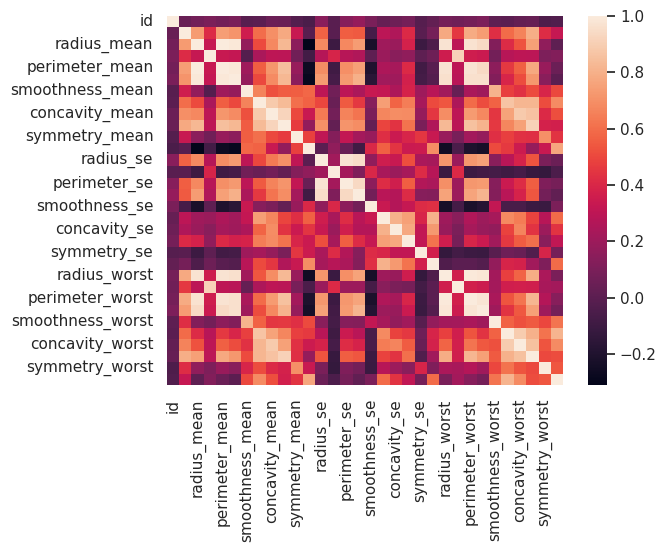

In [44]:
# YOUR CODE HERE
sns.heatmap(breast_cancer.corr())

Resize the heatmap

<Axes: >

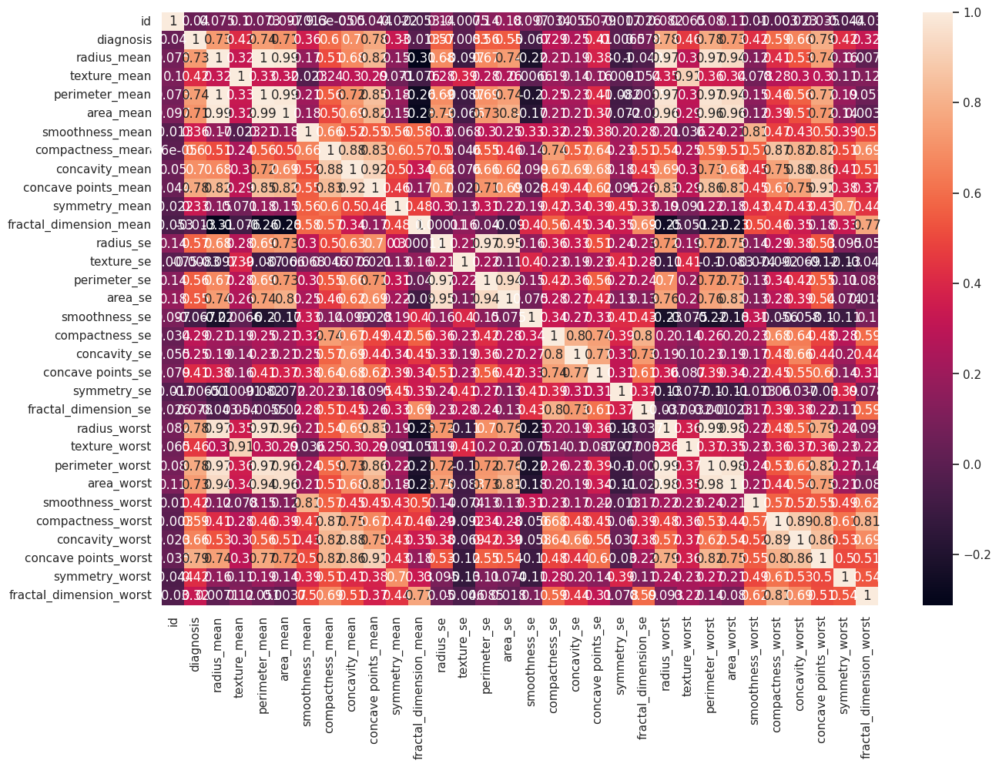

In [45]:
# YOUR CODE HERE
plt.figure(figsize=(15,10))
sns.heatmap(breast_cancer.corr(), annot=True)

Express correlation as a percentage

In [46]:
# YOUR CODE HERE
corr = breast_cancer.corr()
corr.style.background_gradient(cmap='coolwarm')

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
id,1.000000,0.039769,0.074626,0.099770,0.073159,0.096893,-0.012968,0.000096,0.050080,0.044158,-0.022114,-0.052511,0.143048,-0.007526,0.137331,0.177742,0.096781,0.033961,0.055239,0.078768,-0.017306,0.025725,0.082405,0.064720,0.079986,0.107187,0.010338,-0.002968,0.023203,0.035174,-0.044224,-0.029866
diagnosis,0.039769,1.000000,0.730029,0.415185,0.742636,0.708984,0.358560,0.596534,0.696360,0.776614,0.330499,-0.012838,0.567134,-0.008303,0.556141,0.548236,-0.067016,0.292999,0.253730,0.408042,-0.006522,0.077972,0.776454,0.456903,0.782914,0.733825,0.421465,0.590998,0.659610,0.793566,0.416294,0.323872
radius_mean,0.074626,0.730029,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,0.679090,-0.097317,0.674172,0.735864,-0.222600,0.206000,0.194204,0.376169,-0.104321,-0.042641,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.099770,0.415185,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,0.275869,0.386358,0.281673,0.259845,0.006614,0.191975,0.143293,0.163851,0.009127,0.054458,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.073159,0.742636,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,0.691765,-0.086761,0.693135,0.744983,-0.202694,0.250744,0.228082,0.407217,-0.081629,-0.005523,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.096893,0.708984,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,0.732562,-0.066280,0.726628,0.800086,-0.166777,0.212583,0.207660,0.372320,-0.072497,-0.019887,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,-0.012968,0.358560,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,0.301467,0.068406,0.296092,0.246552,0.332375,0.318943,0.248396,0.380676,0.200774,0.283607,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.000096,0.596534,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,0.565369,0.497473,0.046205,0.548905,0.455653,0.135299,0.738722,0.570517,0.642262,0.229977,0.507318,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.050080,0.696360,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,0.336783,0.631925,0.076218,0.660391,0.617427,0.098564,0.670279,0.691270,0.683260,0.178009,0.449301,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.044158,0.776614,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,0.166917,0.698050,0.021480,0.710650,0.690299,0.027653,0.490424,0.439167,0.615634,0.095351,0.257584,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661


**13.** From the given lists `sleeping, eating, working and playing` hours on a scale of five days, perform a Stackplot, with the following measures:
* Add colors to differentiate each list of data
* Place a Legend accordingly

days = [1,2,3,4,5]

sleeping =[7,8,6,11,7]

eating = [2,3,4,3,2]

working =[7,8,7,2,2]

playing = [8,5,7,8,13]

In [47]:
# YOUR CODE HERE
days = [1,2,3,4,5]
sleeping =[7,8,6,11,7]
eating = [2,3,4,3,2]
working =[7,8,7,2,2]

**14.** For the given DataFrame below, perform the following plots along Two Rows and Two Columns:
* Line Plot with following measures,
  * `marker = 'o', alpha = 0.4`
* Line Plot with following measutes,
  * `linestyle = 'none', marker='D', color="green", alpha=0.3`
* Scatter Plot with following measures,
  * `c = df['y'], alpha = 0.3`
* Scatter Plot with following measures,
  * `c = df['x'], alpha = 0.3`

DataFrame({'x': range(1,101), 'y': np.random.randn(100)*15+range(1,101) })

In [48]:
# Defining the data
df = pd.DataFrame({'x': range(1,101), 'y': np.random.randn(100)*15+range(1,101) })

<Axes: xlabel='x', ylabel='y'>

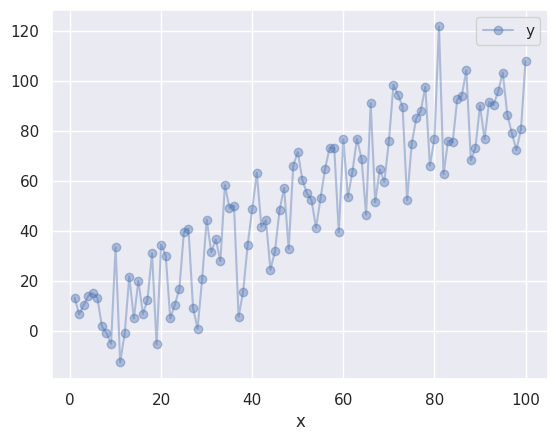

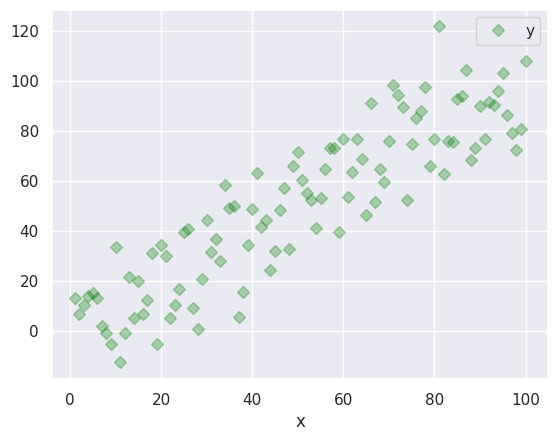

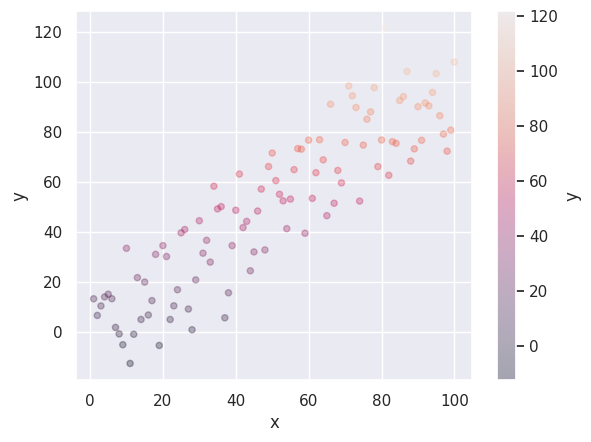

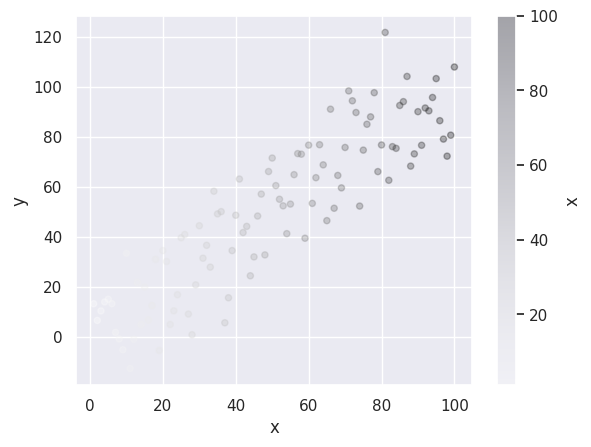

In [49]:
# YOUR CODE HERE
# line plot:
df.plot(x='x', y='y', marker='o', alpha=0.4)
# linestyle = 'none', marker='D', color="green", alpha=0.3
df.plot(x='x', y='y', linestyle='none', marker='D', color="green", alpha=0.3)
#scatter plot: c = df['y'], alpha = 0.3
df.plot(x='x', y='y', kind='scatter', c='y', alpha=0.3)
#scatter plot: c = df['x'], alpha = 0.3
df.plot(x='x', y='y', kind='scatter', c='x', alpha=0.3)

**15.** For the given dictionary of IMDB Genres data, perform a Pie Plot with the following measures:
* **Explode** the 'Biography' Sliced section

IMDB_Genres = {

'Action': 133,

'Biography': 64,

'Comedy': 267,

'Sci-Fi': 32

}

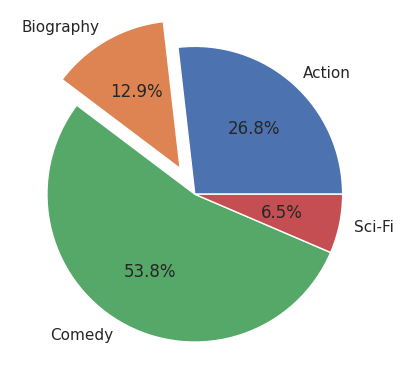

In [55]:
# YOUR CODE HERE
IMDB_Genres = {'Action': 133, 'Biography': 64, 'Comedy': 267, 'Sci-Fi': 32}
#pie plot:
plt.pie(IMDB_Genres.values(), labels=IMDB_Genres.keys(), autopct='%1.1f%%', explode=(0,0.2,0,0))
plt.show()

**16.** For the given x, y, z values given below, perform a 3D Plot

z = np.linspace(0, 1, 100)

x = z * np.sin(20 * z)

y = z * np.cos(20 * z)

Text(0.5, 0.92, '3D line plot')

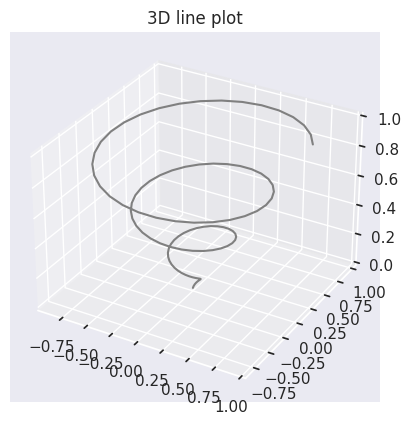

In [57]:
# YOUR CODE HERE
z = np.linspace(0, 1, 100)
x = z * np.sin(20 * z)
y = z * np.cos(20 * z)

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.plot3D(x, y, z, 'gray')
ax.set_title('3D line plot')

**17.** For the X values below, do the following:
* Calculate the squares of X values and store it in y1 variable
* Calculate the Log to the Base 10 of X values and store it in y2 variable
* Plot the respective (X,y1) & (X, y2) as Sub-Plots Horizontally

X = np.arange(1,10)

y1= np.square(X)

y2=np.log10(X)


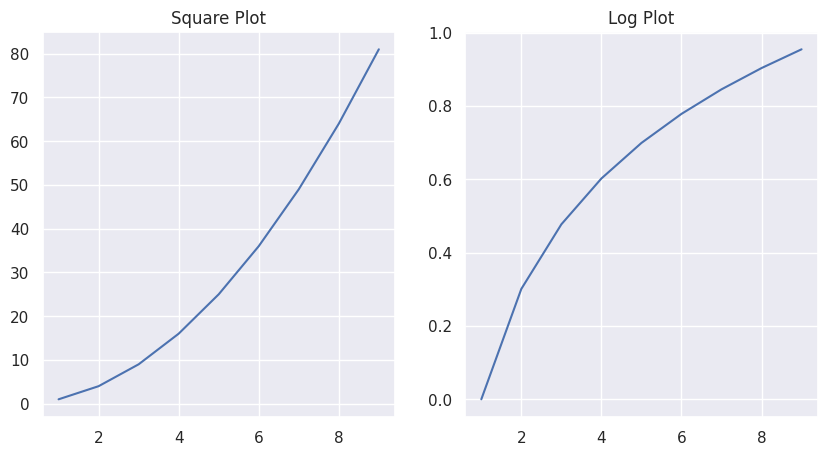

In [58]:
# YOUR CODE HERE
X = np.arange(1,10)
y1= np.square(X)
y2=np.log10(X)

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].plot(X, y1)
axs[0].set_title('Square Plot')
axs[1].plot(X, y2)
axs[1].set_title('Log Plot')
plt.show()

**18.** Plot parallel co-ordinates graph to IRIS dataset.

In [59]:
# Reading the data
iris = pd.read_csv( 'iris.csv' )

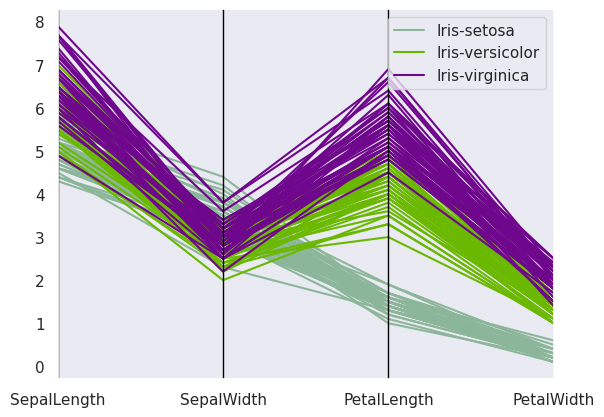

In [62]:
# YOUR CODE HERE
pd.plotting.parallel_coordinates(iris, 'Name')
plt.show()

**Tree based models**

**19.** Construct a simple regression tree for the Hitters dataset.

**Basics of decision trees - Hitters data**
We use the Hitters data set to predict a baseball player’s Salary based on Years (the number of years that he has played in the major leagues) and Hits (the number of hits that he made in the previous year).

We first remove observations that are missing Salary values, and log-transform Salary so that its distribution has more of a typical bell-shape. (Recall that Salary is measured in thousands of dollars.)

In [68]:
hitters = pd.read_csv('Hitters.csv')
hitters.dropna(axis=0, how='any', subset=['Salary'], inplace=True)
hitters.head()

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,League,Division,PutOuts,Assists,Errors,Salary,NewLeague
1,315,81,7,24,38,39,14,3449,835,69,321,414,375,N,W,632,43,10,475.0,N
2,479,130,18,66,72,76,3,1624,457,63,224,266,263,A,W,880,82,14,480.0,A
3,496,141,20,65,78,37,11,5628,1575,225,828,838,354,N,E,200,11,3,500.0,N
4,321,87,10,39,42,30,2,396,101,12,48,46,33,N,E,805,40,4,91.5,N
5,594,169,4,74,51,35,11,4408,1133,19,501,336,194,A,W,282,421,25,750.0,A


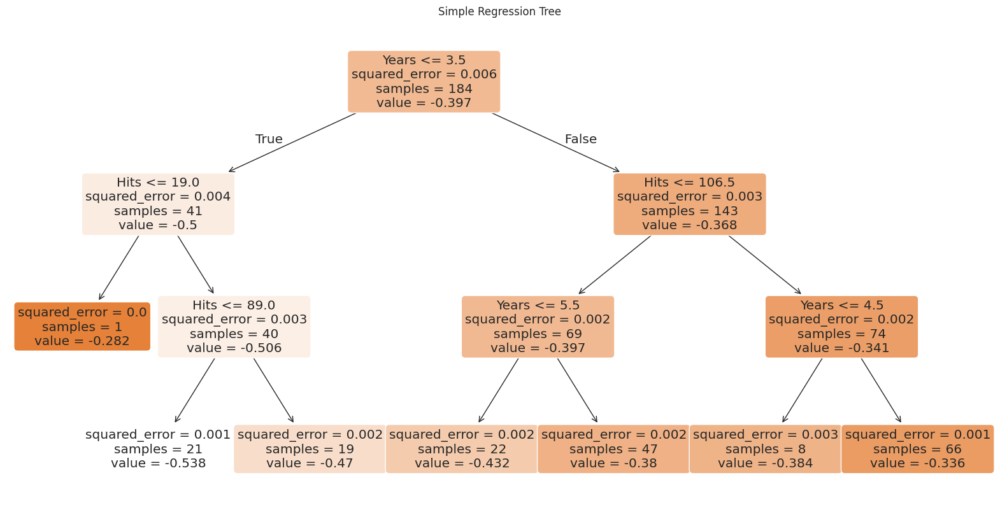

Mean Squared Error on Test Set: 0.0


In [71]:
# YOUR CODE HERE
hitters['Salary'] = np.log10(hitters['Salary'])


# Construct a simple regression tree for the Hitters dataset.
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error as MSE
from sklearn.tree import DecisionTreeRegressor, plot_tree

X = hitters.loc[:, ['Years', 'Hits']]
y = hitters.loc[:, 'Salary']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

reg_tree = DecisionTreeRegressor(max_depth=3, random_state=42)
reg_tree.fit(X_train, y_train)

plt.figure(figsize=(20,10))
plot_tree(reg_tree, feature_names=X.columns, filled=True, rounded=True)
plt.title("Simple Regression Tree")
plt.show()

y_pred = reg_tree.predict(X_test)
mse = MSE(y_test, y_pred)
print("Mean Squared Error on Test Set:", round(mse, 2))

### Please answer the questions below to complete the experiment:




#### Consider the following statement(s) about Matplotlib and Seaborn and answer Q.1.

A. Matplotlib plots various graphs (such as bar, pie, lines, scatter plots) using Pandas and NumPy.

B. Seaborn library is basically based on Matplotlib which uses Matplotlib along with Pandas and NumPy for plotting graphs.

In [ ]:
#@title Q.1. Which of the above statement(s) is/are True? { run: "auto", form-width: "500px", display-mode: "form" }
Answer1 = "" #@param ["","Only A", "Only B", "Both A and B", "None of the above"]


#### Consider the following statement(s) about Matplotlib and Seaborn and answer Q.2.

A. Matplotlib has multiple figures can be opened, but need to be closed explicitly.

B. Seaborn automates the creation of multiple figures. This sometimes leads to OOM (out of memory) issues.

In [ ]:
#@title Q.2. Which of the above statement(s) is/are True? { run: "auto", form-width: "500px", display-mode: "form" }
Answer2 = "" #@param ["","Only A", "Only B", "Both A and B", "None of the above"]


In [ ]:
#@title How was the experiment? { run: "auto", form-width: "500px", display-mode: "form" }
Complexity = "" #@param ["","Too Simple, I am wasting time", "Good, But Not Challenging for me", "Good and Challenging for me", "Was Tough, but I did it", "Too Difficult for me"]


In [ ]:
#@title If it was too easy, what more would you have liked to be added? If it was very difficult, what would you have liked to have been removed? { run: "auto", display-mode: "form" }
Additional = "" #@param {type:"string"}


In [ ]:
#@title Can you identify the concepts from the lecture which this experiment covered? { run: "auto", vertical-output: true, display-mode: "form" }
Concepts = "" #@param ["","Yes", "No"]


In [ ]:
#@title  Text and image description/explanation and code comments within the experiment: { run: "auto", vertical-output: true, display-mode: "form" }
Comments = "" #@param ["","Very Useful", "Somewhat Useful", "Not Useful", "Didn't use"]


In [ ]:
#@title Mentor Support: { run: "auto", vertical-output: true, display-mode: "form" }
Mentor_support = "" #@param ["","Very Useful", "Somewhat Useful", "Not Useful", "Didn't use"]


In [ ]:
#@title Run this cell to submit your notebook for grading { vertical-output: true }
try:
  if submission_id:
      return_id = submit_notebook()
      if return_id : submission_id = return_id
  else:
      print("Please complete the setup first.")
except NameError:
  print ("Please complete the setup first.")